In [1]:
import pandas as pd
import numpy as np
import xlrd
import math
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt

In [2]:
pr = pd.read_excel("./data/Privacy Rights Clearinghouse Top Breaches.xlsx")
br = pd.read_excel("./data/Balloon Race Data Breaches Filtered.xlsx")
#Names columns correctly (Run only once)
pr.columns = pr.loc[0,:]
pr = pr.loc[1:,:]

br.columns = br.loc[0,:]
br = br.loc[2:,:]

In [3]:
br_stories = br.loc[:,'story']
pr_stories = pr.loc[:,'Description of incident']
stories = []
stories = br_stories.tolist() + pr_stories.tolist()
len(stories)

764

In [4]:
stories

['Jun 2004. A former America Online software engineer stole 92 million screen names and e-mail addresses and sold them to spammers who sent out up to 7 billion unsolicited e-mails.',
 'Apr 2005. Computer backup tape containing personal information was lost.',
 'Jun 2005. Blame the messenger! A box of computer tapes containing information on 3.9 million customers was lost by United Parcel Service (UPS) while in transit to a credit reporting agency.',
 "Jun 2005. CardSystems was fingered by MasterCard after it spotted fraud on credit card accounts and found a common thread, tracing it back to CardSystems.  An unauthorized entity put a specific code into CardSystems' network, enabling the person or group to gain access to the data. It's not clear how many of the 40 million accounts were actually stolen.",
 'Aug 2006. Derp. AOL voluntarily released search data for roughly 20 million web queries from 658,000 anonymized users of the service. No one is quite sure why.',
 'Jul 2006. The Vetera

In [5]:
boring = pr.loc[413, 'Description of incident'][:33]
boring
pr_interesting = []
for story in pr_stories:
    if(story[:33] != boring):
        pr_interesting.append(story)
len(pr_interesting)

br_interesting = br.loc[br['interesting story'] == 'y'].loc[:,'story']
interesting_stories = pr_interesting + br_interesting.tolist()
len(interesting_stories)

210

In [6]:
def allUniqueWords(docList):
    uniq = []
    for text in docList:
        terms = text.split()
        for word in terms:
            word = word.lower()
            if word not in uniq:
                uniq.append(word)
    return uniq

In [7]:
def computeTF(docList, unique):
    data = pd.DataFrame(columns=unique)
    for i in range(len(docList)):
        data.loc[i] = np.zeros(len(unique))
    row = 0
    col = 0
    for text in docList:
        terms = text.split()
        for word in terms:
            word = word.lower()
            data.loc[row, word] += 1 
        row += 1
    return data
#whole = computeTF(descriptions, unique)
#print(whole)

In [12]:
def computeTFIDF(TF, unique):
    doc_data = pd.DataFrame(columns=unique)
    doc_data.loc[0] = np.zeros(len(unique))
    #print(doc_data)
    N = TF.shape[0]
    for i in range(N):
        for word in TF.columns:
            print(word)
            if (TF.loc[i, word] > 0):
                doc_data.loc[0, word] += 1
    for word in doc_data.columns:
        doc_data.loc[0, word] = math.log10(N / (1 + doc_data.loc[0, word]))
    for word in TF.columns:
        for i in range(N):
            TF.loc[i, word] = TF.loc[i, word] * doc_data.loc[0,word]
    return TF

In [9]:
def Nmaxelements(list1, N): 
    final_list = [] 
  
    for i in range(0, N):  
        max1 = 0
        maxi = -1
          
        for j in range(len(list1)):      
            if list1[j] > max1: 
                max1 = list1[j] 
                maxi = j 
        list1.remove(max1); 
        final_list.append(maxi) 
    return(final_list)

In [ ]:
def allPronoun(text):
    pro = []
    terms = text.split()
    for word in terms:
        if(not word.islower):
            pro.append(word)
    return pro[0,3]

In [10]:
unique = allUniqueWords(stories)
TF = computeTF(stories, unique)
TF

,jun,2004.,a,former,america,online,software,engineer,stole,92,...,grade,affected.about,"reset,",district.“the,eliminate,threat,implement,improvements,"again,”","email."""
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
759,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
761,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
762,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
TF.shape

(764, 5712)

In [ ]:
TFIDF_story = computeTFIDF(TF, unique)
TFIDF

jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible


expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requestin

plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolin

pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
c

eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecros

37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117

developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;


it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
memb

marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
d

coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
c

police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visi

ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-me

posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
su

list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
det

rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
ch

further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
c

forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-onlin

these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unvei

salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
tempo

exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
conc

perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the

gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we


carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
mod

silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
add

fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.

derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.


sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
follow

vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
suppl

accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https:

google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
comprom

500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
le

down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000

cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receip

passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
re

lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consu

$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
in

66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
proce

fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves

"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestra

coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
r

affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers

profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
r

uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
2

(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surger

linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
addres

county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guar

partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refun

notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
a

memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
di

holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group

nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder

prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deput

do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26

fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves

involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
exe

hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems

items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture


representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.

viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least


days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachell

posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
su

owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
bus

crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
att

delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
sp

depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
sav

though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab


understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
v

maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.


accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
w

obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunet

counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
co

universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age

install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
b

individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carryin

(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)

files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
pay

current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
an

1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-w

way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.co

communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
th

hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
du

franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
fi

done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteris

relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
enve

deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor


alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunate

updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta


computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuatio

peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came


year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1p

2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
rece

age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
unite

stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
c

perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seek

controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,


originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
pre

making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempti

identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing

lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb

nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across


t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire


georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relate

francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
ser

zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
pas

launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
mag

paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patien

was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
exto

later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
f

worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hid

fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,0

data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.


portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
dev

toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work


office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitu

2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(pos

car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
ev

commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(swede

"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18

agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced

into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
secu

impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2

co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in


string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
st

candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
faci

didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citig

i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,

fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
pas

actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
r

outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18


kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,

chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.


updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta


candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
faci

fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensit

buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in

permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree

birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
1

assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
te

theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mar

significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-tim

possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,


campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor

spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem


consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,

guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amou

election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fash

oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anon

clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
vi

github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
inje

aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing


health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
su

diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
co

id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however


my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri

187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,


given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhab

incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tr

source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investig

sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacke

eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
m

vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
intervie

2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufac

broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.th

storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed


claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn'

decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https:/

6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanyi

regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled

480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspire

must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
u

33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth

server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence

somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsiz

fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’

frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questio

banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
wri

warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've

post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminari

avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explana

effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident

mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
frenc

anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified.

app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.

658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
pr

systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspec

barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s

incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
appro

additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patien

750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
childr

law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,

senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville

code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary


identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
u

10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
bu

canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoi

attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
th

congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
ch

younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injec

tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobi

lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
u

ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
reveal

requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.

purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.depart

ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
q

game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%

content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s

former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute

ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
an

size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
f

davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
inst

pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
count

3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
a

misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.

dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
em

settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
d

dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notoriou

recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguar

reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190


citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospi

database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,

theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
r

transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
t

physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illust

report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
n

angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allow

twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.imme

period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
ap

altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,


30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-

effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.

(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.

role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardwar

transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
res

precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,


isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest

by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose


lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consu

volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
sp

10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'sli

agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
detai

site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sh

little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-da

19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
dis

quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note

journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.


boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coa

public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defe

collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
co

telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsi

28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remedia

affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village

cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
9

her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
pu

research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told


(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voter

responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
advis

stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordere

world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
celle

closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-erro

sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-se

tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
pol

“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-up

profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
shar

undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634


flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routin

voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e

sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
cr

"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
indivi

night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emaile

discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platform

remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant'

reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-info

kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decom

founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
cus

patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
c

5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
sta

swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
dec

mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we


men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
ca

nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lis

january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fash

snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management

stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7

belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisb

residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
ept

nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
prob

police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
st

ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks


taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're

intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
mo

complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were

"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant

important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.clo

amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"tw

palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,

jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended


internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
impo

misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.

16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
o

cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security


ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
n

beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
re

extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little

barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledg

order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passw

gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
b

shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
iden

1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs


smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
l

remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,

core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
ma

license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,


messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways

year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1p

inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers

role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardwar

stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown

services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
po

“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massach

been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea

us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address

account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,


go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
re

“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"

field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
expo

variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool

lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
l

sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis


america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.acc

victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belon

fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
a

freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
config

analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
pr

apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed


extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
15

growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting

hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte


dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children

necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
comm

ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spre

dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around

researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
nee

presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
respons

situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control

misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corpora

period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
ap

kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometim

demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
d

night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emaile

teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate.

"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpa

fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials

bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
revie

cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hi

bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchant

http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
w

69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000


operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eli

change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
l

seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’

earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managin

measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
an

ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
gr

readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemee

retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
li

currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.t

for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monste

departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s


(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profil

improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-bre

$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
apprecia

screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
wo

method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
i

remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois

core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
ma

hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
ye

impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
aff

should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
clo

london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
auth

australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-

steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circu

hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
perform

friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes

investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billio

elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
8

arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological

victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belon

company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
r

providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalid

30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station

electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour


higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
57

117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit

theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
r

passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
v

exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disab

stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000


2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
s

claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
eviden

phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
childre

(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
ins

“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
cons

alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
orig

responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard

cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
cli

sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
remova

response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks


licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/1

it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.


gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.

situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control

operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
departme

institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morga

forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nat

vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
e

browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-re

blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(il

exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
d

perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the

suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
di

2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,

mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing


prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.althoug

an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
emp

reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing

distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease

signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco


1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,


completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december

cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipien

cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lo

wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
s

coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,

malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
lea

2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past


logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
p

collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
po

impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stole

conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively


families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadshee

airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month

morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.

result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"incl

system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
informati

school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homel

saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.abo

(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
t

fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far


eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inf

accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
com

amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened

2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychia

sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
th

real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients.

contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypasse

publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
re

times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,0

145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“cont

accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail

"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digit

india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
a

bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
re

dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
f

needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,34

developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam

21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.

collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
po

crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the

wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
pe

sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,

seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
serve

language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
devi

2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”

announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading


fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
sat

security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est

cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees


genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity


gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news


declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
fil

1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor


2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew

manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
b

review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees


amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needss

during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return


much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's

learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager

encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
ube

web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
to

central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdere

victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-med

hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big

tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incen

18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
lik

kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-pr

precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator
280
google,
yahoo..
.for
username
search.
key
minute.the
code-sharing
github.
lecturer
course
creating
datathe
“big
five”
psychology
assess
characteristics,
conscientiousness,
agreeableness
neuroticism.
age,
relationship
people..
tied
de-anonymising
done
easily.
“you
re-identify
update,
date,”
dixon.
reports:the
nonprofit
county's
hotline
vulnerability.upguard,
mountain
view,
calif.,
notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based


classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
t

breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted


we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits


mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-att

89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-ma

indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
pay

ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountere

209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle

email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
imp

w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
mov

anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.

january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affecte

backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matchin

website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partn

marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
c

10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
bu

little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed

breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
speciali

sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring

coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware

detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
su

pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
p

mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
atto

kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
an

existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,

4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
priv

manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affec

user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
int

or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-

700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nat

mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."htt

analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
sta

decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeti

correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris

private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
po

$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/sal

among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance

said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://w

leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.

copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stor

academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.

hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
penn

specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common

steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laur

build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
ski

self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident

situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,

log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
fi

17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
faci

possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday

associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/

blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nua

years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
natu

maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
p

associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/

arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
net

(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
req

information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution

mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’

shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystem

(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marita

internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
r

riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
o

disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research

subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
t

publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
in

launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”


l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
comin

carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
ve

integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.aj

"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition

api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud


450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
cod

2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs

javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payme

eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
m

stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
be

fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijac

oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anon

92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
pro

maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment

assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
te

t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)

federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,00

least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app


booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama


officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
s

taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
ca

during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return


indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
em

teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watch
executive,
travis
kalanick,
condition
anonymity
private.the
officer,
sullivan,
fired.
kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well

for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monste

$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
l

open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
news

surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
co

par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating

world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
dev

790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
veri

cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklaho

adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify

addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid


systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected


giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.th

border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutt

collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patien

bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti

paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
illicitly
easy.the
highly
psychological
tests.
meant
anonymously,
poor
precautions
deanonymising
hard..
.facebook
suspended
violated
language
shared.more
completed
tests
project.
scooped
researchers.
terms
distribute
manner
user”.to
collaborator


car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
new

origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar

licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
deb

afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t


lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
l

similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
de

7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
d

teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate.

super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type


million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
a

news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
cap

data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.


charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.


australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilitie

trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
w

accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at

deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
creden

cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catere

[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
a

transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
att

begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
ava

scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
america

duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.


spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongsid

complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
pas

suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
a

hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial


digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile


mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
ca

companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions

gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
mill

10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
fede

specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
res

kalanick
forced
june,
remains
uber’s
board.the
riders
approached
9.
assault
clery
act
2012.the
andrew
sharing
platform
afs
user,
stanford,
news.
greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
emba

spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swin

day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
reporters
scripps
news
"hackers"
170,000
identifying
theft
sitting
accessible
160,000
exploiting
adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,

"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.

spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why

credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
r

developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;


bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage

“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.

subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settle

successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent

security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est

vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
as

10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
b

clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unma

networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api

owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
wor

(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
l

ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
tennessee.according
gizmodo,
views
method
absentee
providing
identification."
"nearly
bloomberg
terminal
participating
identities
unmasked
london
participants
employers
room,
learned.the
mayor
mike
bloomberg’s
moderators
metal
mining
chat,
focused
macroeconomic
energy,
participants.but
effect
"unmasking,"
greater
rippling
throughout
325,000
subscribers.but
“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patien

wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
y

leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specif

85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
u

discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'


contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
b

ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers

"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongod

7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
d

specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresse

adobe
cold
fusion
macrumors
involved
"a
moderator
logged
escalate
privileges
goals
credentials
vietnamese
contends
began
orchestrated
then-teenager
vietnam,
hieu
minh
ngo.
ngo,
posing
investigator
based
singapore,
13
prison.
deep
giant's
details.
swathe
removed
(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relatin

problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,

greatly
appreciate
daily’s
handling
prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing

account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape

tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
a

green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$

notes
abuse..
.it
211
l.a.
hotline..
.chris
director
upguard's
cyberspace
weakly
opening
server.the
substantial
33,000
2016.in
elderly
woman
dementia
son.
another,
meth
addict
suicidal.
paranoia
verge
evicted.
shots
discovery.
zack
reports:at
teenagers'
children.the
teensafe,
"secure"
android,
lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wir

same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
edu

problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
re

undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
port

necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concern

november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
w

leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federati

identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
arden
hills-based
serving
catholic
church
upper
midwest
130,000
members.the
unidentified
beneficiary
log-in
accessed."
"tarte
cosmetics,
cruelty-free
cosmetics
sephora
ulta,
databases.the
data."
"uber
rider
kept
ransom.the
arranged
watc

entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
name

abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
pl

bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.
understand
brochure
cost
half-million
$200,000.
i
pwned,
analyzed
post
tuesday,
breakdown
entirely
us-focused,
represented
demographic
2.7
hunt's
analysis
showed
dept.
defense,
101,013
followed
closely
88,153
army,
air
force,
combined
76,379
at&t,
boeing,
dell,
fedex,
ibm,
xerox
each.
"whilst
together
domain,
aggregated
fashion
enormously
valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti

bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).
driver'slicense
(if
hire
process)."
"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.

portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charge

genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity


ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spre

said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
la

accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at

$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
extern

officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
s

bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
d

server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
chattanooga,
tenn.
encoded
encrypted.
stated
evidence
due
specialized
nature
hardware
"hillary
clinton
thousand
diplomats
around
world
going
heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence

56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
f

thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
mu

activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
me

relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bit

maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
ma

soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit


accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders

appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
erro

memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase

it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
black

team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitu

hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.

in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
pa

paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
ch

website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employees-following-breach/...
"on
22,
motherboard
someone
data—including
addresses—on
950,000
coachella.com
week
concert-promoter
goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
id

contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.howeve

soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit


players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gen

“unmasking,”
subscribers."
30,000
saturday
breach.the
students'
data.officials
though
identity-protection
affected."
"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
1

audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
informatio

least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app


orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spir

"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar'

discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss

company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
accessing
oregon
motor
vehicles
database.
dmv
once
marketing
stopped
late
1990s.
gender
ages
registered
dmv,
login
steam
forum
id
cybercrooks
presumed
operating
russia
restaurant
depot
100,000
customers.
game
maple
story
leaked.
care
runs
children’s
hospitals
1.05
password
name
each
patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney


cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft

"two
aetna
hiv
envelopes
large,
window
purchasing
prescriptions.the
aids
pennsylvania
neighbors
result."
"st.
mark’s
surgery
33,877
patients.the
8,
17.
prevented
time.the
information."
plastic
associates
dakota
10,200
ransomware.
removing
decrypting
experts.while
associates’
cleanup
efforts
24.
can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209

servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
tabl

patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10


fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cyberscoop.cloudpets’
public-facing
authentication
required.
indexed
engines
shodan
requirements
own
offers
security.in
mid-january,
ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://ww

conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senato

screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
wo

conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
curren

retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
scho

years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement

accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
reve

response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks


project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
frankl

banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
conte

2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
ne

206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
m

relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connec

“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hour
midday
2.among
value
numbers."
t-mobile‘s
bug,
patched,
phone’s
imsi
(a
identifies
subscribers).
way
writing
script
69.6
victims."
ar

mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity

would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
ch

facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper

password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
e

llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
advisory
airline.“no
passport,
id,
skymiles
impacted.”
form
general,
par
electrical
contractors,
"~25,000"
persons.
accompanying
container
that,
par's
regular
practices,
off-site.
.
employees.we
dataincluding
deposit).

engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied

leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments


entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project

not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pu

virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
broker

plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
delete
joe
sullivan
resigned.
uk
poland
look
affected.
indian
response
snapchat
ceo
stating
plans
expand
'poor
countries'
like
india.
confirm
leak.
misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
adm

immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s

signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data
personality
intimate
questionnaires,
access,
found.academics
mypersonality
insufficient
provisions,
gaining
il

ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healt

calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,


my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri

recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password

heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
close

responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer
for,
refused
anything.
us's
hackers,
holders.
july,
already
highest
level
privilege
bank’s
servers.
freedom
request
release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak

can’t
rule
data."social
licenses,
credit/debit
conditions,
women’s
pennsylvania,
45
risk.the
workstation
16.
forensics
team.the
leveraging
vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-br

inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"

patient's
plan.
active
retired
military
personnel,
families,
up-tapes
capture
preserve
1992
2012.
man,
surnamed
zeng,
leaking
6
china
developer
(csdn).
zeng
detained
charges
illegal
acquisition
detecting
“unauthorized
access”
processing
system.
counts
violating
confidentiality
laws
count
disclosure
228,000
medicaid
beneficiaries.
finding
vulnerability
iran's
system,
manager
khosrow
zarefarid
formal
ceos
banks
across
country.
ignored
findings,
accounts,
least
22
banks,
point.
support
disaster
preparedness
exercise.
'misplaced'
texas
attorney
general
greg
abbott
gave
attorneys
against
state’s
voter
utah
recently
moved
server,
eastern
europe
able
circumvent
server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspri

grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happ

too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,

incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"s

wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000


david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"includes
tracking
145,000
successful
transactions",
conversations.
sexual
preferences,
postal
70m
calls,
plus
recordings.
recording/storing
attorney-client
calls
violates
constitutional
protections.
157k
stolen,
15,600
monitoring
massive
t-mobile.
drivers
sometime
february,
peruse
slack’s
central
days.
480,000
2.4
talktalk
mobile
1.9m
carphone
warehouse
directly.
british
airways
frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
ha

society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distr

necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concern

staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
d

harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
years,
payer’s
card.
nationalities,
expired
experience,
email,
marriage
status,
children,
politics,
height,
weight,
license,
literacy
level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
pl

$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfort

officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
residence.many
profile.
why
needed,
database.other
enrollment
classes,
taking,
offered.that
give
insight
capabilities
departments
country."**
disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
offici

misconfigured
spambot
700m
fake
repeated
newest
app's
cellebrite's
main
product
rips
phones.
900gb
cellebrite.
unknown.
israel-based
sign-in
expose
problem
identifiied.
police),
workers
hadn't
usual
checks.
question
whether
sweden's
harmed
censored
säpo
(sweden's
police)
report.
city’s
3.7
registration
electoral
venue
election."
dodgy
rcm's
operations.
site's
database,
decided
get
himself.
somebody
bell
leaks
if
don't
cooporate.
dataset
$1000.
imgur
investigating
place.
type
numerous
telco
mvno
providers,
celcom,
digi,
umobile,
maxis,
friendi,
merchantrade
asia,
tunetalk,
redtone,
xox,
altel,
pldt
enablingasia
council
(mmc),
association
(mma),
dental
(mda)
user's
instagram
verified
admitted
non-verified
hasn't
6m
amazon
s3
cloud
bucket
wide
open
facing.
you
report,
there’s
good
chance
you’re
143
equifax,
nation’s
sha-1,
weak
20yr
hash
program.
2018.
vulnerabilities
click2gov,
software,
local
networks
46
cities.
people,
prime
minister
lee
hesien
loong.
governments
accept
payments
14m
ye

supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable

person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
empl

scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consume

travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook

wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,
record.the
a.
turiano,
bressler,
amery
ross,
florham
park,
n.j.,
suit.
lawyers,
aaron
zeisler,
ms.
turiano
hands."
anthem
enrollees,
insurer's
theft.anthem
launchpoint
ventures
"emailed
companies'
address,"
ago.in
18,500
members'
insurer
24,
members,
spokeswoman."anthem
post:
https://www.anthem.com/blog/member-news/launchpoint-privacy-concern-impacts-medicare-members/
polling
machine
ebay
def
con
conference
las
vegas
650,000
voters.organizers
decommissioned
machine,
expresspoll-5000,
village,
tested
(with
frightening
results).
blank
memory,
shelby
ten

discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,


rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
public

result
incorrect
configuration.
researcher
stumbled
leak,
notified
kromtech,
patched
quickly.
arab
emirates
bank,
$3m
bitcoin
stop
tweeting
mostly
corporate
dumped
basketball
team,
storage.
invest
won't
ransom.
3.3m
sanrio's
sanriotown.com
links
sanrio
hello
kitty
portals.
children's
tablets
photos
italian
cybersecurity
sells
digital
surveillance
organisations.
400
gb
code,
messages
bittorrent.
show
products
repressive
regimes.
hookup
extra-marital
severely
37m
users,
release.
notorious
outfit
impact
team
responsibility.
shutdown
am.com
sites.
forms
submitted
clearances.
everything
eye
colour,
substance
abuse,
individual's
relatives
intruders...
to...employees’
assignments,
performance
training
visa
leaders
attending
g20
brisbane
summit
organisers
asian
cup
football
tournament.
barack
obama,
vladimir
putin,
angela
merkel,
xi
jinping,
narendra
modi,
david
cameron
others.
"an
unnamed
cybermafia
irs
posed
legitimate
taxpayers,
may.
away
them,
crooks
15,000
claim
refunds
names."
dark
"incl

turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-r

1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“c

identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
presc

(i.e.
expiration
etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
req

contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
k

vulnerability.
files.the
couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
i

exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
vol

processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
gle

ransomed
critically
vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-not

firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
documents.
fortunately,
encrypted.however,
infect
incident."
groups
again
hijacking
asking
victor
gevers,
chairman
gdi
foundation."one
hijacked
22,000.
$650
restore
data.the
initial
continued
launch:
simply
external
content,
replaced
demand."
time."the
"anthem
blueshield
affecting
anthem’s
coordination
ventures,
indiana.launchpoint
misusing
non-anthem
enrollment.
included."
image-sharing
teens
couple
ago
2008
2013.although
secure,
notes."
"if
kicked
october
hut
pizza,
patrons
alerting
app.roughly
60,000
“third
intrusion.”
28-hou

spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
computer
backup
tape
containing
personal
information
was
lost.
blame
the
messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swin

36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blackmailer

block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
intercepted
information.the
discovered.this
nc
38
months.on
49,000
minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary


issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident,
trove
wealthiest
clients.the
1.4
fargo’s
copious
spreadsheets
paired
investment
portfolios
fees
advisors,
arm
caters
high-net-worth
investors.by
estimate,
clients
billions
dollars
invested
fargo,
laid
vivid
detail
him
lawsuit.the
handed
protective
orders
agreement
place
lawyers
fargo’s.
court,
perfectly
legal
material
filings,

shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research,
113.5
emergency
contacts
complete.
"earlier
anomalous
facilitated
exchanges,
ffe’s
pathway
agents
brokers.
pathway,
ffe.
individuals’
fraction
ffe,
unacceptable."
marriott
reservations
resorts
guests.according
marriott,
327
guests,
diego
unified
january,
district
2008-09
discipline,
scheduling
grade
affected.about
reset,
district.“the
eliminate
threat
implement
improvements
again,”
email."
jun
2004.
a
former
america
online
software
engineer
stole
92
million
screen
names
and
e-mail
addresses
sold
them
to
spammers
who
sent
out
up
7
billion
unsolicited
e-mails.
apr
2005.
c

server’s
multi-layered
claims.
dropbox
acknowledged
time
occurred,
didn't
full
extent
hack.
scrambled
answers
knowingly
blizzard's
internal
network.
blizzard
would
elaborate
size
("millions").
databases.
physician’s
improperly
portal
physicians
provide
treatment
mhs.
specifically,
patients’
amazon-owned
e-commerce
target
cyber
formspring
tipped
420,000
hashed
forum.
suspects
reportedly
earnt
$877,000
8.7
kt
subscribers,
almost
half
carrier's
yahoo
voices
exposing
450,000
usernames
passwords.
2016.
join
date,
records,
newsletter
sign-ups
ad-related
2012
'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting

psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
n

atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions

heart
wake
morning
find
entire
repository
classified
foreign
policy
available,
searchable
format,
...
everywhere
there's
us
post,
diplomatic
scandal
will
beautiful,
horrifying"
so
wrote
bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
40

frequent-flyer
airline
viewed
frozen
resolves
issue.
id/
initially
seemed
turned
117
tumblr
independent
researchers
65m
2014,
no.
smaller.
real
2.6tb
politicians,
criminals,
professional
athletes
mossack
fonseca,
contracts,
scanned
documents,
transcripts...
comelec
anonymous,
warning
government
mess
elections,
calling
'cyber
justice
team'
10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
stateme

delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bleepingcomputer.com/news/security/hackers-breached-departme...http://www.ajla.net/pressrelease.html
continues
serviced
med
affiliates
2014.it
take
mail
bowling
green,
scottsville,
franklin,
commonwealth
regional
specialty
hospital,
cal
turner
rehab
ems
employee.david
habich,
counsel
louisville,
investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conductin

houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scraped
profiles,
consolidated,
stitched
together."
"suntrust
“criminal
party,”
underscores
consumers’
suntrust,
“not
significant
activity”
involved."
unitypoint
dealing
"after
review,
following:
surgical
medications,
point,
advising
steps:
covered
care.review
“explanation
statement”
recognize.
necessary,
(noted
above)
date.
year-to-date
beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezo

individual
subscribers
publication.
gaming
hacked,
breaching
total
38,000,000
300,000
workers’
compensation
benefits
access.
lulzsec
12,000
originate
writerspace.com.
200,000
users.
includes
sega
pass,
interested
newsletters
registering
products.
1%
citbank
holders'
contact
codes
unencrypted,
“sony
1,000,000
plaintext."
1
compromised.
75,000
music
coupons
uncovered.
mismailed
letters
allowed
lines
(medication
name,
member
id)
visible
through
envelope
window.
mailings
addressed
correctly
knowledge
company,
received
intended
recipients.
unknown
broke
washington
post's
jobs
stealing
1.27
ids
addresses.
drives,
listing
patients'
ages,
last
digits
password-protected
file
billing
holding
missing
nhs
room
wasn't
3
later.
unsecured
storing
viruses
it.
unclear
infected
playstation
compromised
77
23,000
sony.
identification
company’s
ecommerce
websites
myhonda
myacura
1,500
departmental
computers
w32.qakbot
virus,
“downloads
files,
steals
opens
door
computer”.
sheriff's
detectives
tim
nuss
acces

dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo

prompt
university,”
wendi
wright,
stanford’s
officer.
promptly
intensive
addition,
urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarant

action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory

hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
i

involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https://oag.ca.gov/ecrime/databreach/reports/sb24-65922more
http://www.beckershospitalreview.com/healthcare-information-technology/c...
"sources
half-dozen
unions
independently
48
inquire
i’d
heard
anything
arby’s
fast-food
restaurants.
rumors,
told
krebsonsecurity
remediated
involving
nationwide.a
atlanta,
ga.-based
industry
mid-january
gone
fbi.“arby’s
inc.
(arg)
provided
prompted
launch
systems,”
written
krebsonsecurity."more
https://krebsonsecurity.com/2017/02/fast-food-chain-arbys-acknowledges-b...http://www.esecurityplanet.com/network-security/arbys-hacked.html
internet-connected
stuffed
toys
kids
parents
voice
recordings,
hunt.
locked
ransom.researchers
reach
spiral
toys,
fix
problems
cloudpets
brand.
manufacturers
hit
passed
researchers.the
magnitude
victims
families
textbook-example
long
come.
virtually
worthless
stock
prices
activity.
does
appear
functioning
answered
months,
monday
cybe

couldn’t
pregnancy
diagnoses.
restored
backups
disrupt
care."
davis
patients.officials
15,
proceeded
account.once
inside,
phi.
possibility."
michigan-based
mclaren
(mmg)
mmg
healthitsecurity.com.the
authorizations,
orders,
appointment
scheduling,
mmg’s
mid-michigan
p.c.
practice.scanned
"time
warner
cable,
spectrum,
realize
entrusted
safety
records.kromtech
cloud-based
aws
buckets,
connected
broadsoft,
public.
spanned
10,
7,
mac
development
dumps
"equifax,
states.equifax
29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory


disclaimer
**
reflects
available.if
representative
inaccurate,
chronology@privacyrights.org
update
record.
catalin
cimbanu
11
california.the
43.5gb
dataset,
10,999,535
users.all
yahoo-based,
suggesting
larger
servers..
.while
owner
suffix
--such
"content-saverspy-09092018"--
suggested
saverspy.combining
diachenko
saverspy.com,
saverspy.com
operate
coupons.com
brand,
quotient
today
saverspy
affiliate
program."
"attack"
50,000,000
feature
facebook’s
officials.more
90
morning,
measure
accounts.facebook
attackers,
fully
assessed
scope
stages
investigation."
release,
alphabet
shutting
google+
500,000
users.underlining
strobe
audit,
apis:users
grant
friends,
apps,
api.the
static,
optional
occupation,
age.
site.)
posts,
g
suite
content.we
api’s
interaction
subsequent
change.we
mind
therefore
patching
438
api.we
abusing
api,
misused.
sec,
chegg,
specializing
textbook
rental,
techchrunch:fitmetrix,
gym
mindbody,
.last
fitmetrix
data.it
shodan,
ports
september.bob
diachenko,
hacken.io’s
research

etc.).
36m
customers:
3.1m
cards,
33m
correction
2015:
we
previously
152m
taken,
remainder
invalid,
inactive,
out-of-date
associated
brokers
dun
bradstreet
corp
kroll
background
inc,
altegrity.
lexisnexis.
lexisnexis
conducted
thorough
ssndob
underground
teenage
collect
exposed.su,
listed
birthdays,
previous
dozens
celebrities
beyonce,
kanye
west
michelle
obama.
doing
believe
installed
machines
swipe
magnetic
strips
paying
merchandise
stores.
40m
now
70m!
“clandestinely”
neiman
marcus
16
oct.
30
send
spam
messages.
community
systems,
operates
206
5
breached.
"chinese
hackers"
responsible.
goal:
text
publically
available
wide-ranging
every
piece
including:
unreleased
films
scripts,
salaries
check
results,
relating
lay-offs,
restructures
executive
salaries.
lead
"north
perhaps
seth
rogen
film,
"the
interview"
mocks
north
dictator,
kim
jong
un.
attended
2014
unprotected
site.
webcrawlers
individuals.
early
“a
small
number”
part”
credentials.
51
branches
24
states.
ecb
requesting
much
blac

minors
recipients,
attributed
1,615
granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospect

citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
issues
firing
record,
paper/films
laptop,
svr
tracking,
“vehicle
recovery,”
provides
around-the-clock
cars
trucks,
towed
achieve
“continuous”
“live”
updates
vehicle’s
attached
discreet
somewhere
isn’t
notice
it.according
svr’s
unit
“continuous
minutes
moving”
“four
hour
heartbeat
stopped.”
basically,
120
accessible,
right
app,
downloadable
desktops,
laptops,
device."email,
identifications
fayetteville-based
arkansas
oral
128,000
patients.an
26,
detected,
x-ray
images,
doc

$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst
countrywide,
2
year
period.
hack
primarily
effected
u.s.
prepaid
gift
issuing
business
rbs
worldpay.
actual
has
committed
100
cards.
certain
1.5
cardholders
individuals
affected
and,
group,
1.1
accessed.
feb
south
korea’s
shopping
site
attacked
chinese
hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/sal

panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
month

self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
epting
night:
scenario
download.”at
point
allowed.in
discoverable
microsoft
delve,
29,000
instances
ou’s
constitute
violation
family
act,
gives
records."
kansas
commerce
5.5
hook
victims.the
ssns
collaboration
kcur,
radio,
kmuw
plains
request.more
commerce.the
connect
jobs,
kansasworks.com,
resumes
openings.
managing
affected.in
805,000
exposed."
"when
lawyer
gary
sinderbrand,
wells
fargo
subpoenaed
defamation
mr.
sinderbrand
expected
selection
case.but
landed
sinderbrand’s
for:
accident

adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
underwent
powers
alerrt
university.the
organization,
protection..
officer's
numbers.officials
fbi,
customs
border
(cbp),
patrol
database.in
table,
65,000
feedback
exposed.another
table
histories
instructors,
skills
training,
17,000
instructors.another
51,345
geolocation
coordinates
courts,
departments,
buildings,
halls
offices.
interest,
gather
malls.
contained,
officers'
marked
r

volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law
enforcement
agencies.
campus
subject
malware
attack,
exposed
students
--
present
alike.
anonymous
defaced
website
stratfor
what
claimed
stratfor's
client
list,
along
47,680
unique
50,277
—
9,651
yet
expired.
50%
easily
crackable.
firm's
list
released,
rather
individual
subscribers
publication.
gaming
hacked,
breaching
total


vulnerable
databases,
suffer
fate.
unlike
responded
demands,
appears
silent
deleted
times
next
days.sensitive
exposed,
hunt
wrote,
notified."more
https://www.cyberscoop.com/internet-connected-teddy-bear-company-hacked-...
boeing
36,000
co-workers
spreadsheet
non-boeing
spouse.news
surfaced
letter
(.pdf)
boeing’s
deputy
privacy
marie
olson,
bob
ferguson,
ferguson’s
website.forty-seven
states,
washington,
legislation
books
requires
entities
whenever
personally
identifiable
law,
required
notify
general’s
affects
residents.
instance
7,288
impacted.according
letter,
nov.
21,
2016
encountered
formatting
spouse
didn’t
work
sensitive,
aircraft
manufacturer’s
bemsid,
accounting
albeit
“hidden
columns,”
olson.spreadsheet
microsoft’s
excel,
usually
authors
select
hidden,
prevent
seen,
changed,
deleted.according
olson’s
jan.
9,
begin
inform
later,
feb.
8.in
destroyed
copies
carried
“forensic
examination”
employee’s
spouse’s
ensure
deleted."more
https://threatpost.com/boeing-notifies-36000-employee

accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
poten

lets
child's
when,
browsing
apps
installed.although
controversial
privacy-invasive,
doesn't
require
consent
children.but
angeles,
calif.-based
servers,
password..
parent's
corresponding
address.
often
device's
identifier.
id.
two-factor
off,
actor
viewing
needs
break
data.none
action,
parent
real-time
complete.shortly
offline,
duplicates.teensafe
athletic-wear
preliminary
adidas
adidas.com/us
consumers,”
spokeswoman
email.
wired,
"exactis,
broker
palm
coast,
florida,
340
haul
comprises
adults,
precise
isn't
clear—and
seem
numbers—it
go
minute
listed,
characteristics
name.
interests
habits
person's
children."it
pretty
citizen
it,"
troia,
founder
york-based
night
lion
troia
he's
searched
found.
wired
"i
don’t
know
coming
from,
comprehensive
collections
i’ve
seen,"
says."aside
breadth
exactis
remarkable
depth:
variables
characteristics:
smokes,
religion,
dogs
cats,
varied
scuba
diving
plus-size
apparel.
authenticity,
outdated
inaccurate."
federally
funded
shooter
zdnet
officers,
agents,
u

400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
center.
shore
hospital
hired
destroy
longer
shipment.
driver’s
record
plan
information,
diagnoses
treatments.
well
some.
patients,
physicians,
volunteers,
donors,
vendors
partners
effected.
betfair
waited
gambling
site,
alarming
banking
institutions
experts.
betfair's
breach,
occurred
march
april
uncovered
until
may,
crashed.
date
healthcare
services
diagnostic
codes.
43,000
affiliated
publicly
viewable
google
10
months.
morgan
stanley
mailed
cd
investors
tax-exempt
funds
bonds
taxation
finance.
package
arrived
building
relevant
desk
3.5
people's
mailing
cases
driver's
barclaycard
us,
capital
one,
jp
morgan,
citigroup
firms
rounding
thoroughly
unhappy
sony,
third
saw
76,000,000
sony
psn
qriocity
collective
lulzsec.
"antisec"
2,719
8,214
passwords,
15,798
48,182
street
1,531,628
106,691
53
70
different
law

goldenvoice
let
know.
"usernames,
shipping
birth"
"confirmed
stolen,"
"no
accessed."goldenvoice
coachella
implemented
strategies
barging
supposed
"please
remember
solicit
email,"
noted.
exercise
caution
receive
direct
information."no
advice,
idea
anyway."more
http://mashable.com/2017/03/01/coachella-hack-names-emails/#prexwijuxeqh
universal
care,
dba,
medicare
approved
plan.on
28,
became
aware
ephi
hipaa
associates.
vendor
day’s
contracting
2016.the
notification
indicate
types
numbers.upon
discovery
terminated.
rapid
block
says
error
eliminated
‘within
hours’
breach.while
mention
improper
made,
“we
practices
requiring
user.”
performing
‘self
audit’
errors
jeopardize
confidentiality,
integrity
availability
ephi.as
precaution
theft,
offered
months’
complimentary
mitigation
experian.the
services’
civil
rights
indicates
14,005
incident.
delayed
interfere
breach."more
http://www.hipaajournal.com/configuration-error-vendor-results-exposure-...
carolina
12,731
error.
homes
potentially,
interc

urgently
managers
permissions
files.”while
graduate
school
teams
investigated
exposure,
21
salary
non-teaching
august
snapshot.
mba
well."
"paypal's
recently-acquired
processor
tio
breach.last
week,
vancouver,
canada-based
suspension
operations,
"unauthorized
access."in
"locations
tio's
billers."in
total,
(pii)
ancestry's
rootsweb.com
hosts
genealogical
users.hile
rootsweb.com's
surname
55,000
belonged
ancestry.com,
services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”


hacker
made
off
18
members
large
amount
multimedia
cell
email
workplaces
korean
sorted
age
office
worker
backstreet’s
pile
seoul.
experts
gs
caltex
purposes
given
there
signs
hacking.
car
bonus/salary
info
at&t
employees.
tens
past
stanford
employees
-
birth,
stored
drive
petty
employee's
car.
according
reports
tried
failed
view
using
vhs
player.
chile
published
six
illustrate
weakness
security.
"jefferson
county
clerk
jennifer
maghan
said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data

10gb
websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
b

29.
"criminals
exploited
files,"
said."equifax
customers.the
209,000
obtained,
"certain
dispute
182,000
consumers."link
equifax
notification:
https://www.equifaxsecurity2017.com/
update:
(10/02/2017):
"equifax
2.5
estimated,
bringing
145.5
counted
before.
forensic
mandiant
investigate
finished
sunday."https://www.usatoday.com/story/tech/2017/10/02/equifax-breach-hit-2-5-mi...
(02/10/2017):
friday,
senator
elizabeth
warren
(d-mass.)
paulino
do
rego
barros
jr.
,
interim
citing
'what
misleading,
incomplete,
contradictory
information'
congress
145
americans.
week.equifax
'names,
instances,
numbers…credit
numbers…and
information,'
said.but
wall
journal
'such
[equifax]
disclosed,'
added."https://www.mediapost.com/publications/article/314389/
cache
americans
online.the
totaling
593,328
sets
alaska,
database.the
couchdb
browser
needed
subsequently
pulled
offline."
26,000
recipients'
broken
prepared
fired
friday.the
aug.
defense
yolanda
farrar
dismissal
amy
webb
farrar's
23
"within
minutes"
iss

messenger!
box
of
tapes
on
3.9
customers
lost
by
united
parcel
service
(ups)
while
in
transit
credit
reporting
agency.
cardsystems
fingered
mastercard
after
it
spotted
fraud
card
accounts
found
common
thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000


could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
seco

investigations
investigate.a
taking
procedure
records.emailed
responses
daily
indicated
“other
agencies”
investigating.a
center,
investigators."more
http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52

beneficiary.
recognize.the
apologized
learn
questions,
855-331-3612.
wallet
25,000
newly
bezop.
security.john
mcafee,
adviser
board
bezop,
bezop
amazon.com”
twitter
post.
cryptocurrency.
adding,
added,
cryptocurrency,
“bezop
tokens”,
stream
transactions.
bombas
socks
develop
purchases.
finally
transactions
impacted,
41,000
existed,
essentially
1,
removed.what
involved?the
zdnet's
zach
whittaker
reports:"a
t-mobile's
number.the
fixed,
knew
little-known
subdomain
tools.
promotool.t-mobile.com,
hidden
api
adding
customer's
end
address..
.the
returned
customers'
past-due
suspended.the
references
pins
contacting
support."t-mobile
74
users.pumpup,
ontario-based
bills
community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
nee

resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
atte

victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?).in
3,
"learned
[its
appointment]
waits
delays
year's
weekend
ehc
restored."in
learned
"that
searches
traditionally
notifies
remedied."the
referenced
mackeeper
that's
mongo
"contained
appeared
information,"
healthcare.
domain
(reverse
ip)
brain
center,"
wrote."more
http://www.databreachtoday.com/emory-healthcare-database-breach-what-hap...
well-known
cloudflare
chat
messages,
keys,
cookies,
hotel
more.
delivery
quickly
finding,
traced
coding
character
remediations
place.but
cached
engines,
triggered
frantic
effort
remove
flaw
publicized.
normally
ssl/tls,
form.it's
difficult
decide
prudent
reaction
be."cloudflare
specializes
improving
redundancy
offe

"advanced-online",
advanced
products,
inc.,
22,182
"advanced-online
2018
range
2017until
2018."
medium
flaw,
inti
de
ceukelaire,
"nametests.com,
quizzes,
app.
.who
affected?according
nametests
insights
abused,
attacker’s
attacker.what
leaked?depending
quizzes
took,
javascript
language,
picture,
cover
photo,
currency,
use,
updated,
posts
statuses,
friends.what
deleted?if
afterwards,
read
birth.
happening
offer
logout
functionality."
sacramento
bee
routine
maintenance
month,
leaving
19,501,258
additionally,
52,873
compromised.“we
seriously
misuse
information,”
paper
share
aging
(kdads)
disseminated
kdads
associates.on
attachment
in-home
participation
banking,
included.all
explaining
situation.
please
http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.record

paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
database
incuded
incentive
payment
dates.
allow
use
special
characters
punctuation
passwords
e-mailed
plain
text.
advantage
lapses,
simple
techniques
32
accounts.
checkfree's
sites
12:35
a.m.
10:10
day
attack
redirected
ukrainian
server
malicious
try
install
password-stealing
victim's
computer.
large-scale
infection
wordpress-driven
blogs
led
compromise
573,000
hacker,
never
arrested,
demanded
$10
effecting
530,000
virginians.
taken.
35
prescription
records.
extortion
demand
posted
wikileaks
sought
return
8
prescriptions
virginia
professions.
all
36
servers
shut
down
protect
attackers
public
bypassed
additional
secured
databases
same
server.
addition
ssns,
non-treatment
medical
portable
seven
net
being
reported.
first
destroying
defective
repair
recycling
held
detailed
76
veterans,
dating
1972.
2010.
laptops
health-related
57
closet
bluecross
center
ch

software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates.'
histories,
2017.
17.5m
dated
sha-1
ancestry.com's
community-driven
rootsweb
forged
cookies
log
uber
$100,000
del

prudent
reaction
be."cloudflare
specializes
improving
redundancy
offering
protection
attacks
distributed
denial-of-service.
link
widely
downstream.the
"months,"
google's
tavis
ormandy,
project
zero,
bug.
jokingly
dubbed
cloudbleed,
portmanteau
recalls
heartbleed
openssl
lingers:
180,000
vulnerable).a
redacted
sample
source:
ormandy.cloudflare
domains.
nick
sweeting,
co-founder
cto
blitzka
4.3
cloudlfare,
aims
narrow
display
error.so
far,
ormandy
uber,
1password,
fitbit
okcupid.
manager,
ways,
thus
little
consequence
users.more
http://www.databreachtoday.com/cloudflare-coding-error-spills-sensitive-...
"hackers
america's
alliance
(ajla),
labor
(dol),
undisclosed
seekers.ajla,
multi-state
seekers,
website.hackers
seekers
statesaccording
ajla
officials,
users.an
managed
ten
sixteen
catered
portal.affected
alabama,
arizona,
arkansas,
delaware,
idaho,
illinois,
kansas,
maine,
oklahoma,
vermont.
currently,
georgia,
indiana,
kentucky,
nevada,
jersey
massachusetts
affected."more
https://www.bl

community,
discover
workouts
advice
coaches
users.but
core
backend
amazon's
cloud,
signing
contents
real-time..
.each
message.the
town
timezone.
bio,
workout
goals,
resolution
photos,
blocked,
rated
app.the
user-submitted
points,
caffeine
alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcripti

said
she
unveiled
tool
enabled
residents
professionals
1.6
documents
her
via
computers"
more
89,000
lottery
winners
(including
prize
amounts
)were
taken
agency
without
permission
copied
password-free
added
he
wanted
"for
possible
future
reference
programmer
state
agencies."
97,000
employees,
sue
starbucks
california
winning
appeals
court
before
losing
higher
federal
unable
prove
any
cognizable
harm
injury.
oct
very
sensitive
armed
forces
personnel
passport
national
insurance
etc
went
missing.
revealed
during
identity
prevention
week.
got
hands
device
data,
some
high-profile
german
citizens.
did
contain
details,
call
"tax
authorities
accidentally
cd-roms
filled
tax
returns
living
norway,
country
just
4.6
inhabitants,
editorial
staff
newspapers,
radios
television
stations."
usbs
about
lives
staff.
jan
2009.
biggest
scam
history,
heartland
eventually
paid
$110
visa,
mastercard,
express
associations
claims
related
breach.
years
his
role
cases.
131,000
army
guard
potentially
when
owned
data

websites.
seems
leaks,
though.
players
lifeboat
turkish
citizenship
food
outlets
banner
locations.
game-related
forums
hosted
mail.ru.
hack,
number
come
light.
fitness
courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blamin

granville
department.
provider’s
incidents
individual’s
indications
services,
possibility
ruled
latest
monitor
precaution.in
similar
occurring
future,
policies
procedures
changed.
emailing
future.
should
intercepted,
identified."more
http://www.hipaajournal.com/north-carolina-department-health-human-servi...
alleged
georgia
election
kennesaw
university,
atlanta
journal-constitution
learned.
situation
developing,
secretary
friday
georgia’s
6.6
voters.
officials.in
afternoon,
“working
maintained
systems.
involves
pending
further
comment
inquiries
attorney’s
office,”
said."more
http://www.ajc.com/news/state--regional-govt--politics/fbi-investigating...
"new
commercial
52
gigabytes
size,
33.7
representing
portion
bradstreet,
giant,
owns
2015
buy
netprospex
$125
million.the
purchased
fields,
titles
functions,
sourced
location,
unit,
descriptions
kind
falls
into,
advertising,
legal,
broadcasting,
telecoms.
marketers
want
directly
campaigns
methods
prospective
either
bulk,
exactly
rate
size.


suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.technology
24]7.ai,
delta,
kmart
clients,
sept.
resolved
[24]7.ai.
impacting
firm,
buy,
holdings.the
2017.“we
[24]7.ai’s
fields
manually
completing
purchase
delta.com
timeframe:
date.”
reads
a

thread,
tracing
back
cardsystems.
an
unauthorized
entity
put
specific
code
into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
se

'dwdm'
uploaded
6.5
russian
another
discovered.
analysis,
93%
could
top
10,000
list.
4
gamigo
warned
intrusion
portions
users'
credentials,
emails
163,792
ip
"single"
personnel.
antisec
fbi
apple
identifiers
(udids).
subsequently,
app
bluetoad
source
udids
online.
greece
83%
country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employ

world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody
aadhaar
govt.
deals
allows
see
blocked
grindr
non-public
exact
opted
location
sharing.
travel
orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesse

co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
originated
overseas
enforcement,
fdacs
statement.
pose
“no
theft,”
announcement
“the
entered
field
employer
entered,”
“in
2009,
fein
practice
fein.
“only
licensees
renewed
accessed,”
continued.
department’s
inspector
determined
licensees.”
prominent
beverly
hills
surgeon
affect
spokesman
doctor
officials.a
dr.
zain
kadri’s
“stole
passwords”
photographed
surgery.
office,
declined
identified,
countries
states.“despite
discovered,
started
staffer
2016,”
read.a
palmdale
residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
sta

alcohol
consumption,
smoking
frequency,
concerns,
injuries.also
advertiser
identifiers,
needing
password.users
signed
putting
risk.in
values
ticketfly
27
myheritage's
4,
2018:[on]
1pm
est,
myheritage’s
myheritage
myheritage.
reviewed
passwords.immediately
receipt
file,
identify
exploitation
92,283,889
breach..
.we
example,
with,
trusted
(e.g.
bluesnap,
paypal)
trees
dna
segregated
layers
techradar
reports:pageup,
australia-based
compromising
worldwide.the
producing
hr
recruitment
190
countries,
australia
companies.while
revealed,
malware.
pageup
colleges
universities
onboarding
swarthmore
college,
wisconsin
oshkosh,
mississippi
massachusetts,
bucknell
colorado
mines,
rollins
pageup's
testimonials
page.
reports:nuance
communications,
speech
transcription
platforms,
45,000
individuals'
records.see
also:
matching
needsso
san
francisco
health,
patients..
.breach
zuckerberg
laguna
honda
hospital.
department,
breach.their
"determined
nuance
nuance's
contracted
health,"
scientist
reports:data

bradley
manning,
22-year-old
intelligence
analyst,
suspected
behind
leak
250,000
dispatches
embassies
world.
hacked.
usernames,
emails,
system
(illegally)
restricted
areas
website.
cannot
reasons
because
incident
still
under
investigation.
2003
addressees,
cases,
drivers'
license
officials
discovered
removal
housed
technology
(oit)
ipad
3g
website,
thought
include
those
white
house
chief
rahm
emanuel.
130,495
patients
protected
cds
transit.
education
3.3
people.
borrowers,
malaysian
man
charged
hacking
major
corporations,
reserve
cleveland
fedcomp
secret
investigators
"400,000
obtained
various
systems
institutions"
document
dump
wikileaks'
short
history
possibly
ever,
whistle-blower
organization
391,832
iraq
war
its
double
whammy.
separate
breaches.
september
3rd,
2010
115,000
electronic
device,
21st
400,000
2011.
york
provider
dec.
23,
2010,
truck
transporting
secure
location.
gamers
seacoast
radiology
rochester
bandwidth
november
play
duty:
black
ops.
process
also
gained
230,000
cent

courses
viewed.
official
statement
having
anywhere.
ubuntu
attacker.
attacker
sql
injection
add-on
older
vbulletin
software.
1025
wendy's
restaurants
currently
impacted.
democratic
presidential
candidate
hillary
clinton's
campaign
part
broad
political
organizations
breached,
exactly,
utorrent
advised
probably
version
world-check,
terrorists
include.
'malicious'
employee.
came
officer
murdered
isis-inspired
attack.
100m
sale
vk
spokesperson
denied
claiming
use.
teen
randomly
statement,
revenge
mh17
crash.
companies
commented,
however
troy
hunt,
researcher,
legit.
nival
km.ru
both
desires
generic
info,
fling.
linkedin
myspace
too,
lots
three's
intention
fraudulently
ordering
handsets
sell
on.
'at
risk
behaviours'
despite
telegram's
super
security,
they've
called
rocket
kitten.
85.2m
extracted,
18.3m
although
bcrypt.
blaming
obtain
currency.
lab
results
adult
friend
finder
penthouse.com.
encrypted,
leakedsource
crack
99%
'the
contains
790,724
plaintext
(the
928,072
entries
all,
duplicates

http://www.bgdailynews.com/news/k-affected-by-med-center-data-breach/art...
"wauwatosa,
wis.-based
urology
ransomware
2016.according
group’s
january
10th,
(mug)
mug
virus.according
(hhs)
(ocr)
portal,
(phi)
17,634
ocr
10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to

http://www.kdads.ks.gov
becomes
available.
persons
incurring
1-800-432-3535.
leave
kahlea
porter
call.
armour
150
myfitnesspal
wildly
"myfitnesspal",
party"
month."under
coordinating
authorities,"
function
bcrypt
passwords."under
emails.
shop
lord
taylor
saks
fifth
avenue
string
years.records
chains’
compromised,
gemini
advisory,
firm.
jersey,
panera
bread
sign-up
(possibly
million)
loyalty
numbers.there
thankfully,
patently
evildoers
campaigns.crucially,
responsive
problem.
houlihan
promising
"working
resolution,"
twice.
evidence"
"large
number"
payment-card
“several
thousand”
fall
companies.the
dates.delta
“small
subset”
affected.the
atlanta-based
wasn’t
(24)7.ai,
customers,
october.
quoting
article
zdnet,
"localblox,
bellevue,
wash.-based
'automatically
crawls,
discovers,
extracts,
indexes,
maps
augments
variety
formats
exchange
networks.'
founding
sources,
linkedin,
zillow
few,
produce
profiles.but
unlisted
password,
allowing
contents.the
bucket,
labeled
'lbdumps,'
unpacked
1.2
scr

hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim.
2008.
hardrive
1m
&
2007,
then
defraud
cutomers
$32,000.
estimated
4.2
numbers
thieves
briefcase
vehicle
private
off-site
company.
anyone
patient
university
miami
physician
visited
um
facility
since
1999
likely
included
tapes.
health
47,000
these
financial
regarding
bill
payment.
back-up
tape,
12
sentenced
tuesday
eight
months
prison
ordered
repay
$1.2
pleading
guilty
downloading
millions
borrower
thumb
drives
selling
loan
officers
pa
consulting
unencrypted
memory
stick
high
risk,
prolific
offenders.
rene
rebollo,
senior
analyst

release
173
journeys
undertaken
taxis
year.
unfortunately,
incorrectly
anonymised
relatively
easy
decode,
revealing
driver
ids,
pickup
dropoff
times,
gps
routes
single
cab
journey.
"in
message
turkey
thwarted
expiry
“compromised”."
airlines
750,000
frequent-flier
programme
members.
genders,
places
work.
staples
believes
point-of-sale
115
locations
customers’
gmail
forum,
alongside
providers.
close
inspection
(3+
years).
multiple
hacks
party
where
dataleak,
method.
itself
cash
register
2,200
stores
syphoned
56
responsible
breaches
target,
sally
beauty
p.f.
chang’s,
among
others
ratings
korea
bureau
(kcb)
accused
working
temporary
consultant.
€30,000
(£24,000)
domino's
pizza
600,000
french
belgian
mozilla’s
accidental
failure
“data
sanitisation”
organisation
carrying
out.
2015.
suggests
member-created
created
carefirst’s
members’
subscriber
number.
twitch's
requested
change
occured
"could
address,
number,
clinical
plates
50,000
partners.
198
voters
result
incorrect
configuration.
researc

valuable,"
tuesday.
"it
serves
reminder
we've
control
privacy;
vast
majority
certainly
it."
ran
pwned's
percent
existed
pwned.
bradshaw
talk
beyond
"we've
carefully
evaluated
shared
format
deliver
day.
system,"
read."more
http://www.zdnet.com/article/millions-of-records-leaked-from-huge-corpor...
"one
spamming
operations
upwards
1.37
raft
information.chris
vickery,
works
anti-virus
mackeeper,
us-based
sms
river
media.
zip
addresses.the
cause
exposure
oversight.
rsync
protocol
mysql
password-protected,
vickery
group.the
time,
duplicates.
offline.
fraudsters
upon
updated
january."if
wild,
damage
astounding,"
says.
"abusive
ex-boyfriends
stalkers
fresh
victims.
wouldn't
feel
once,
society
indeed
time."based
preliminarily
checks,
legitimate,
writes
post."investigating
shows
entry
accurate,"
writes."more
http://www.databreachtoday.com/backup-error-exposes-137-billion-record-s...
emory
appointments
regulators
far
80,000
spotlight
persistent
facing
growing
exerts
(see
hijackings:
who's
next?)

services.
noted
7,000
ancestry.com
users.rootsweb
stated,
noting
reason
ancestry
compromised."https://blogs.ancestry.com/ancestry/2017/12/23/rootsweb-security-update/
jason’s
deli
quantity
“dark
web,”
deployed
ram-scraping
point-of-sales
(pos)
terminals
corporate-owned
facts
pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
1

or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-

country's
population.
35-year-old
possession
9
licence
plate
sell.
breached
international
hacker.
2013.
2005
2012,
ring
targeted
processors
chain
steal
160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
consid

orbitz
expedia.
negligent
plain-text
accessible.
glitch
readable
text,
exposed.
days
ahead
friday.
released.
351,000
booking
2,000
urban
massage
therapists,
dell
disrupted
activity
attempting
extract
order
physical
411,000
tail
hall
players.
poorly
configured
elastisearch
methods.
revealed.
cvv
"sensitive"
applicants
cms
states
insurance,
income
might
scrapers
collected
injected
15
skimming
retailer's
page
14
18.
45m
monthly
visitors,
2019.
federation
desjardins
2.9
173,000
businesses.
travellers'
faces
"malicious
cyberattack"
subcontractor.
blood
testing
providers
personal,
issue
vendors.
academic
students.
139
australian
graphic
design
startup
canva.
estate
title
deal
2003.
statements,
mortgage
wire
transaction
receipts,
images.
influencers,
brand
web.
wi-fi
networks.
3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomot

follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift
schoolzilla,
corrected
students’
hours.
“as
it,
researcher,”
said.unfortunately,
that’s
atypical
response.
respond
suspicion
contrast,
appropriately,
immediate
“this
reacted
professionally,”
“it
must
grueling
relay
unpleasant
news,
report.”
"us
newspaper
giant
gannett
co
18,000
employees.the
stressed
affected.according
usa
today,
co,
30th
perpetrator(s)
attempted
fraudulent
request.this
suspicious
team.officials
stemmed
resources
department.gannett
109
victim
scam,
users."
associate
present:
desktop
yes
concealed
carry
permit
florida
recent
utilized
agriculture
(fdacs)
monday,
turn
469
16,190
weapon
licensees.
origin

duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
24,999
non-driver
combination
pin
flexible
corporation
19438
ssn.
alert
malware,
authorization.
engaged
brands
diligently
so.
indiana
general.
bjc
33,420
nine
months.bjc,
st.
louis,
treatment-related
inform.
unsecure
sears
(shld.o)
delta
inc
(dal.n)
wednesday
[
24]7.ai.department
24]7.ai.a
flight
pushed
gate
airport
salt
lake
utah,
u.s.,
12,
reuters/mike
blakesears
mid-march
customers.tech

home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
couriers.
sep
stolen
contained
people
applied
positions
at
gap
stores,
banana
republic
old
navy,
july
2006
june
contractor
dai
nippon
printing
company
tokyo,
japan
8.6
records
43
company's
clients.
hackers
hacked
minnesota
store
wifi
network
debit
cards
shoppers
off-price
retailers
tjx,
owners
2,500
t.j.
maxx
marshalls.
this
case
believed
be
such
breach
consumer
may
approximately
2.6
current
holders
chase-circuit
city
had
been
mistakenly
identified
trash
thrown
garbage
bags
outside
five
branch
offices
new
york.
nov
set
discs
confidential
25
child
benefit
recipients
td
ameritrade
settled
compensate
6.3
whose
costing
nebraska
brokerage
firm
less
than
$2
per
victim

160
targeting
800,000
rented
photocopier
copy
hard-drive
wiped
return.
big
citigroup."the
150,000
consumers
bankruptcy
2007
2011
–
citi
properly
redact
(pacer)
system."
china's
leaked
resulted
few
hundred
(figure
approximate)
1.7
period
1973
1976,
congressional
correspondence.
criminals
50
said.
happened
2013
disclosed
telephone
dobs,
questions.
2014.
abused
exploit
syphon
4.7m
delaware
acquired
vendor.
limited
session
tokens
encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poit

facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e-sports
entertainment
(esea),
competitive
communities
planet,
december.
result,
player
compromised.on
sunday,
esea
twitter,
reminding
issued
december
30,
2016,
informed
sunday’s
expected,
they’ve
systems."
"copilot
maintains
particular
www.monovischcp.com,1
help
determine
coverage
orthovisc®
monovisc®
injections.
make
inquiry
2015,
copilot
complaints
immediately
launched
retained
leading
assist
occurred.
copilot’s
investigation,
referred
matter
enforcement.
our
understanding
supports
conclusion
individual.
involved?
important
included.
diagnosis
incident,
connection
injections."more
information:
https:/

residence
kadri
burglarized
5,
thursday
los
angeles
sheriff’s
supplies
described
“administrative
office”
uses
office.“nobody
knows
it’s
except
us.
documents,”
said.though
break-in
employee,
witnesses.
ex-employee,
detained,
statement.calls
station
seeking
returned.kadri’s
host
recordings
account,
videos
pictures
earliest
january.“these
approve
this,”
this.”the
duties.
quit
embezzling
said."
computer,
republican
deeprootanalytics
200
voters,
upguard
found.the
unsettling
voters'
party,
self-reported
racial
status.a
root
huffpost,
saying
"we
responsibility
situation."the
undertaking
review
lapse,
begun
lasted
14.
exposure.deep
time.vickery
terabytes
“entirely
unsecured”
9.5
points
describe
potential
voters’
preferences
categories.
categories
span
debate,
voter’s
stance
abortion,
gun
control,
stem
environmental
issues.the
sort."
oklahoma
unintentionally
educational
grades
2002
lax
settings
file-sharing
law.the
safeguard
learning
ou
spoke
vice
president
admissions
matt
hamilton
files.ou
ept

into
cardsystems'
network,
enabling
person
or
group
gain
access
data.
it's
not
clear
how
many
40
were
actually
stolen.
aug
2006.
derp.
aol
voluntarily
released
search
data
for
roughly
20
web
queries
from
658,000
anonymized
users
service.
no
one
is
quite
sure
why.
jul
veterans
affairs
department
agreed
pay
$20
settle
class
action
lawsuit
over
loss
laptop.
originally
took
three
weeks
report
theft.
laptop
recovered
with
apparently
intact
month
reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
secu

encrypted/salted
versions
diagnoses,
disability
codes,
memorial
hollywood,
fla.,
notifying
9,500
investigation
inappropriately
workers,
employment
terminated,
false
4,000,000
administrative
building.
second
ever
human
(hhs).
"some"
275,000
3rd-party
developers
nasdaq
ring,
video
games
publisher
"illegally
accessed",
subscribers'
remained
safe
them.
discussion
password.
cryptographically
md5
hashing
algorithm
considered
inadequate
means
protecting
japan's
club
nintendo
following
accesses.
snowden
downloaded
flew
hong
kong
meet
journalists
glenn
greenwald
laura
poitras
fleeing
moscow.
network's
"download
your
information"
facebook
inadvertently
address
friends
otherwise
private.
assured
bug
fixed
within
day,
maliciously.
evernote
asked
reset
attempt
note-taking
it’d
premium
accessed,
nor
indication
content
changed
application
february
13,
2013,
applicant
birthdates,
race,
detected
japan.
necessary
verification
placed
association.drupal.org
application.
telecom
terracom
yourtel
branded
re

3.1
toyota
lexus
sales
subsidiaries.
dutch
1.8
women,
something
"breedready"
status.
hours
encryption
authentication.
blamed
subcontractor
medicall,
completely
happened.
dubsmash
617
websites,
sharethis
hautelook
anomoto
eyeem
8fit
whitepages
fotolog
armor
bookmate
coffeemeetsbagel
artsy
datacamp
ixigo
127
younow
houzz
ge.tt
coinmama
roll20
stronghold
kingdoms
petflow
photo-sharing
500px
announced
2018,
hashes
passwords),
city,
state,
country),
gender.
freely
online,
7.6
browser-based
"town
salem".
huge
mongodb
citizens
internet
bulgarians
emailed
publications.
relation
github
negligence.
fingerprints.
facial
recognition
likes
metropolitan
police,
defence
contractors
banks.
cyberattack
impacted
2019,
ucla
reached
$2million
class-action
settlement
4.5
patients.
26
invalidated,
wiping
tracked
supply
market.
mental
(omh)
facilities
experienced
research
participants.
28
year,
parts
psychiatric
institute’s
individuals,
statement.the
school,
county,
coded
interviews
questionnaires
cases."
"e

student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
businesses,
manage
currency
market
retailers.over
follow
facebook,
active.
this,
breach."
"more
california-based
kindergarten
12-grade
schools.a
schoolzilla
informing
configuration
error.”the
chris
kromtech
dot
scanning
“all
too
common”
misconfiguration
(amazon
buckets).the
1.3
shortly
realizing
pertained
minors.“the
sheer
volume
[test]
scores
convinced
me
purged
my
expedited
fashion,”
said.the
schools
(and
praised)
swift


pos
beginning
total.
oneplus
40,000
embarrassing
misstep
handset
maker.
comes
landing
oneplus’s
store.oneplus
explanation
website.“one
attacked,
sniff
operated
intermittently,
capturing
user’s
browser.
eliminated.
quarantined
reinforced
structures.”the
mid-november
january.
purchases
saved
“should
not”
affected,
goes
ones
paypal
paypal.
monitoring.
homeland
240,000
dhs
positions,
grades,
duty
stations,
(oig)
management
cyber-attack
actors,
primary
data.what
know:
"cyber-attack
actors."
instead,
agency's
ongoing
maygo
deeper
department's
memo.
4/23/2015
rea.deeming
beauty,
suffered
18,133
11/27/2017
1/5/2018.
29,
talentreef,
account.
11,603
broward
clicked
18,
2017
and/or
44,000
guaranteed
rate,
6/9/2017
10/2/2017
187,788
53,173
1/12/2018,
16,
pension
fund
10981
ss
11/25/2017
mortgage,
llc,
36840
10/3/2017
rbc
royal
66,000
fedex
worldwide
(aws)
119,000
passports,
drivers’
licenses
agent
forms,
massachusetts'
collection
39,000
taxpayers.
business's
payments,
processor.
southern
bancorp
2

reported
but
impossible
say
absolute
certainty
that
accessed
copied.
automatic
processing,
world's
largest
payroll
companies,
confirmed
swindled
thief
looking
hundreds
thousands
american
investors.
press
report:
"tokyo
police
have
arrested
two
men
trying
extort
nearly
us$90,000
kddi
corp.
pair
allegedly
threatened
disclose
existence
storage
media
belonging
four
prior
shareholder
meeting;
however,
alerted
as
soon
they
contacted
blackmailers;
monitored
communications
between
several
weeks.
"
mar
lost/stolen
employee
data:
names,
addresses,
social
security
numbers,
dates
birth
other
employment-related
information.
2007.
trojan
virus
log-ins
used
harvest
user
home
phone
numbers.
phishing
e-mails
encouraged
download
monster
job
seeker
tool,
which
fact
program
encrypted
files
their
left
ransom
note
demanding
money
decryption.
dec
hard
disk
details
candidates
driving
theory
test
premises
iowa
subcontractors.
only
customer
broker,
including
dates,
bank
account
heavily
disks
children
are
courie

level.
origin
researchers,
wordpress
ago,
suggest
actively
wild.
developers,
even
profiles
earlier
planned.
compromised:
logins
visitors
ask
answer
questions
faith,
calculus,
unrequited
love,
meaning
life
starwood
hotels
sheraton,
regis,
w
hotels)
info.
downsized
500
383
non-secure
making
gender,
dob,
externally
engine
query.
most
belong
belgium,
france
uk,
commission
parliament
caused,
nmbs
said,
“clicking
wrong
button”.
cambridge
analytica,
headed
steve
bannon,
harvested
50m
build
profile
adverts.
bakery
chain's
panerabread
2017,
pull
10k
leaked,
figure
37
million.
indians
world’s
biometric
can
bought
£6,
newspaper.
reporter
named
criminal
complaint
filed
dixons
known
cybercriminals
implanted
registers,
siphoning
divulged
estimate
5m
careem's
blog
admit
trip
14.8
voting
history.
bookings
5th
t-mobile
later
norway's
popular
quiz
people’s
years.
pictures,
status
updates,
lists
etc.
third-party
inbenta
technologies
caused
tickets
ios
android
applications
113
gbs
2,271+
firebase
anybody


10th.
categorized
hacking/it
server.“mug
premier,
steps
occur
again.
traffic
servers,”
stated.
further,
“mug
best
firewall
devices
updating
reflect
technological
changes.
conducting
detect
exist
correct
vendor,
digicorp,
undergoing
security.”the
relates
service,
exposed."more
https://www.healthcare-informatics.com/news-item/cybersecurity/wisconsin...
aid
college
helped
$30
government.nearly
irs's
retrieval
transfer
free
student
aid.
17
fafsa
aid.fraudulent
become
irs,
sophisticated
measures
$5.8
alone
sending
filing
names.
schemes
schools,
restaurants,
commissioner
john
koskinen
testified
senate
finance
committee
thursday,
52,000
taxpayers
verify
they're
requests."it
students,
criminals,"
"so
down.""more
https://www.cnet.com/news/hackers-used-college-student-loans-tool-to-ste...
end.
seen
successfully
chains
infections
swiped,
fighting
constant
battle
keep
valuable
hands.in
example
eyes
unaware
compromise.fashion
fantasy
lovers.
platform,
developed
designer
nancy
ganz,
virtual
items
bu

In [ ]:
unique = allUniqueWords(interesting_stories)
TFIDF_interesting = computeTFIDF(computeTF(interesting_stories, unique), unique)

In [87]:
def genWordCloud(docList):
    all_text = " ".join(story for story in docList)
    wordcloud = WordCloud().generate(all_text)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

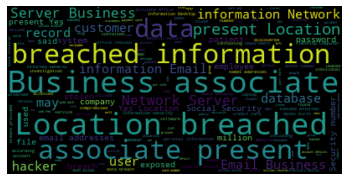

In [92]:
genWordCloud(stories)

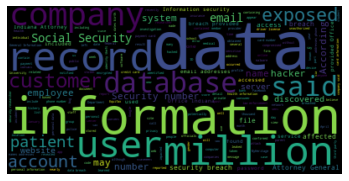

In [94]:
genWordCloud(interesting_stories)